**AIML Online Capstone - AUTOMATIC TICKET ASSIGNMENT**

One of the key activities of any IT function is to “Keep the lights on” to ensure there is no impact to the Business operations. IT leverages Incident Management process to achieve the
above Objective. An incident is something that is unplanned interruption to an IT service or
reduction in the quality of an IT service that affects the Users and the Business. The main goal
of Incident Management process is to provide a quick fix / workarounds or solutions that resolves the interruption and restores the service to its full capacity to ensure no business impact. In most of the organizations, incidents are created by various Business and IT Users, End Users/ Vendors if they have access to ticketing systems, and from the integrated monitoring systems and tools. Assigning the incidents to the appropriate person or unit in the support team has critical importance to provide improved user satisfaction while ensuring better allocation of support resources. The assignment of incidents to appropriate IT groups is still a manual process in many of the IT organizations. Manual assignment of incidents is time consuming and requires human efforts. There may be mistakes due to human errors and resource consumption is carried out ineffectively because of
the misaddressing. On the other hand, manual assignment increases the response and resolution times which result in user satisfaction deterioration / poor customer service.

**Business Domain Value**

In the support process, incoming incidents are analyzed and assessed by organization’s support teams to fulfill the request. In many organizations, better allocation and effective usage of the valuable support resources will directly result in substantial cost savings.
Currently the incidents are created by various stakeholders (Business Users, IT Users and Monitoring Tools) within IT Service Management Tool and are assigned to Service Desk teams (L1 / L2 teams). This team will review the incidents for right ticket categorization, priorities and then carry out initial diagnosis to see if they can resolve. Around ~54% of the incidents are resolved by L1 / L2 teams. Incase L1 / L2 is unable to resolve, they will then escalate / assign the tickets to Functional teams from Applications and Infrastructure (L3 teams). Some portions of incidents are directly assigned to L3 teams by either Monitoring tools or Callers / Requestors. L3 teams will carry out detailed diagnosis and resolve the incidents. Around ~56% of incidents are resolved by Functional / L3 teams. Incase if vendor support is needed, they will reach out for their support towards incident closure. L1 / L2 needs to spend time reviewing Standard Operating Procedures (SOPs) before assigning to Functional teams (Minimum ~25-30% of incidents needs to be reviewed for SOPs before ticket assignment). 15 min is being spent for SOP review for each incident. Minimum of ~1 FTE effort needed only for incident assignment to L3 teams.

During the process of incident assignments by L1 / L2 teams to functional groups, there were multiple instances of incidents getting assigned to wrong functional groups. Around ~25% of Incidents are wrongly assigned to functional teams. Additional effort needed for Functional teams to re-assign to right functional groups. During this process, some of the incidents are in queue and not addressed timely resulting in poor customer service. Guided by powerful AI techniques that can classify incidents to right functional groups can help organizations to reduce the resolving time of the issue and can focus on more productive tasks.

**Project Description**

***Pre-Processing, Data Visualization and EDA***
● Exploring the given Data files
● Understanding the structure of data
● Missing points in data
● Finding inconsistencies in the data
● Visualizing different patterns
● Visualizing different text features
● Dealing with missing values
● Text preprocessing
● Creating word vocabulary from the corpus of report text data
● Creating tokens as required

***Model Building***

● Building a model architecture which can classify.
● Trying different model architectures by researching state of the art for similar tasks.
● Train the model
● To deal with large training time, save the weights so that you can use them when training the model for the second time without starting from scratch.

***Test the Model, Fine-tuning and Repeat ***

● Test the model and report as per evaluation metrics ● Try different models 
● Try different evaluation metrics 
● Set different hyper parameters, by trying different optimizers, loss functions, epochs, learning rate, batch size, checkpointing, early stopping etc..for these models to fine-tune them 
● Report evaluation metrics for these models along with your observation on how changing different hyper parameters leads to change in the final evaluation metric.

# **Libraries**

In [ ]:
#libraries used
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
%matplotlib inline
from wordcloud import WordCloud
import pickle
import os, sys, itertools, re
import nltk
import string
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from nltk.stem.porter import PorterStemmer 
# We will not do stemming, instead use more intelligent way to get the root word using  lemmatization
from nltk.stem import WordNetLemmatizer
from matplotlib import cm
!pip install ftfy
from ftfy import fix_encoding, fix_text, badness

In [ ]:
!pip install googletrans==3.1.0a0
import googletrans
from googletrans import Translator

     |████████████████████████████████| 55 kB 2.3 MB/s 
     |████████████████████████████████| 42 kB 1.3 MB/s 
     |████████████████████████████████| 1.3 MB 10.6 MB/s 
     |████████████████████████████████| 53 kB 2.2 MB/s 
     |████████████████████████████████| 65 kB 3.8 MB/s 
  Created wheel for googletrans: filename=googletrans-3.1.0a0-py3-none-any.whl size=16367 sha256=b2e65b901cc568479ecf7c56e1fba657a5a369db1fbbe89d8d19bdbce5e2e963
  Stored in directory: /root/.cache/pip/wheels/0c/be/fe/93a6a40ffe386e16089e44dad9018ebab9dc4cb9eb7eab65ae
Successfully built googletrans


# **Exploring the given Data files**

In [ ]:
file_path = '/content/drive/MyDrive/Capstone/input_data.xlsx'

ticketData=pd.read_excel(file_path)
ticketData.head()

,Short description,Description,Caller,Assignment group
0,login issue,-verified user details.(employee# & manager na...,spxjnwir pjlcoqds,GRP_0
1,outlook,_x000D_\n_x000D_\nreceived from: hmjdrvpb.komu...,hmjdrvpb komuaywn,GRP_0
2,cant log in to vpn,_x000D_\n_x000D_\nreceived from: eylqgodm.ybqk...,eylqgodm ybqkwiam,GRP_0
3,unable to access hr_tool page,unable to access hr_tool page,xbkucsvz gcpydteq,GRP_0
4,skype error,skype error,owlgqjme qhcozdfx,GRP_0


In [ ]:
ticketData.tail()

,Short description,Description,Caller,Assignment group
8495,emails not coming in from zz mail,_x000D_\n_x000D_\nreceived from: avglmrts.vhqm...,avglmrts vhqmtiua,GRP_29
8496,telephony_software issue,telephony_software issue,rbozivdq gmlhrtvp,GRP_0
8497,vip2: windows password reset for tifpdchb pedx...,vip2: windows password reset for tifpdchb pedx...,oybwdsgx oxyhwrfz,GRP_0
8498,machine nÃ£o estÃ¡ funcionando,i am unable to access the machine utilities to...,ufawcgob aowhxjky,GRP_62
8499,an mehreren pc`s lassen sich verschiedene prgr...,an mehreren pc`s lassen sich verschiedene prgr...,kqvbrspl jyzoklfx,GRP_49


In [ ]:
ticketData.sample()

,Short description,Description,Caller,Assignment group
320,computer in the maintenance dept. is down. ple...,computer in the maintenance dept. is down. ple...,juaxnvwz reampilj,GRP_3


# **Understanding the structure of data**

In [ ]:
print('No of rows:', ticketData.shape[0])
print('No of columns:', ticketData.shape[1])

No of rows: 8500
No of columns: 4


In [ ]:
ticketData.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8500 entries, 0 to 8499
Data columns (total 4 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   Short description  8492 non-null   object
 1   Description        8499 non-null   object
 2   Caller             8500 non-null   object
 3   Assignment group   8500 non-null   object
dtypes: object(4)
memory usage: 265.8+ KB


In [ ]:
ticketData['Assignment group'].value_counts()

GRP_0     3976
GRP_8      661
GRP_24     289
GRP_12     257
GRP_9      252
          ... 
GRP_64       1
GRP_67       1
GRP_35       1
GRP_70       1
GRP_73       1
Name: Assignment group, Length: 74, dtype: int64

In [ ]:
ticketData["Assignment group"].unique()

array(['GRP_0', 'GRP_1', 'GRP_3', 'GRP_4', 'GRP_5', 'GRP_6', 'GRP_7',
       'GRP_8', 'GRP_9', 'GRP_10', 'GRP_11', 'GRP_12', 'GRP_13', 'GRP_14',
       'GRP_15', 'GRP_16', 'GRP_17', 'GRP_18', 'GRP_19', 'GRP_2',
       'GRP_20', 'GRP_21', 'GRP_22', 'GRP_23', 'GRP_24', 'GRP_25',
       'GRP_26', 'GRP_27', 'GRP_28', 'GRP_29', 'GRP_30', 'GRP_31',
       'GRP_33', 'GRP_34', 'GRP_35', 'GRP_36', 'GRP_37', 'GRP_38',
       'GRP_39', 'GRP_40', 'GRP_41', 'GRP_42', 'GRP_43', 'GRP_44',
       'GRP_45', 'GRP_46', 'GRP_47', 'GRP_48', 'GRP_49', 'GRP_50',
       'GRP_51', 'GRP_52', 'GRP_53', 'GRP_54', 'GRP_55', 'GRP_56',
       'GRP_57', 'GRP_58', 'GRP_59', 'GRP_60', 'GRP_61', 'GRP_32',
       'GRP_62', 'GRP_63', 'GRP_64', 'GRP_65', 'GRP_66', 'GRP_67',
       'GRP_68', 'GRP_69', 'GRP_70', 'GRP_71', 'GRP_72', 'GRP_73'],
      dtype=object)

In [ ]:
ticketData.describe()

,Short description,Description,Caller,Assignment group
count,8492,8499,8500,8500
unique,7481,7817,2950,74
top,password reset,the,bpctwhsn kzqsbmtp,GRP_0
freq,38,56,810,3976


1. Our dataset has 4 columns and 8500 rows.
2. There are 74 unique groups in target variable
3. About 3976 Tcikets are assigned to GRP0, while there are many groups
   assigned with only 1 ticket, which shows the distribution of data is
   highly imbalanced.

# **Missing points in data**

In [ ]:
ticketData.isna().sum()

Short description    8
Description          1
Caller               0
Assignment group     0
dtype: int64

1. Short Description and Description columns appear to have null values

# **Dealing with missing values**

In [ ]:
ticketData[pd.isnull(ticketData).any(axis=1)]

,Short description,Description,Caller,Assignment group
2604,NaN,_x000D_\n_x000D_\nreceived from: ohdrnswl.rezu...,ohdrnswl rezuibdt,GRP_34
3383,NaN,_x000D_\n-connected to the user system using t...,qftpazns fxpnytmk,GRP_0
3906,NaN,-user unable tologin to vpn._x000D_\n-connect...,awpcmsey ctdiuqwe,GRP_0
3910,NaN,-user unable tologin to vpn._x000D_\n-connect...,rhwsmefo tvphyura,GRP_0
3915,NaN,-user unable tologin to vpn._x000D_\n-connect...,hxripljo efzounig,GRP_0
3921,NaN,-user unable tologin to vpn._x000D_\n-connect...,cziadygo veiosxby,GRP_0
3924,NaN,name:wvqgbdhm fwchqjor\nlanguage:\nbrowser:mic...,wvqgbdhm fwchqjor,GRP_0
4341,NaN,_x000D_\n_x000D_\nreceived from: eqmuniov.ehxk...,eqmuniov ehxkcbgj,GRP_0
4395,i am locked out of skype,NaN,viyglzfo ajtfzpkb,GRP_0


In [ ]:
ticketData.fillna(str(), inplace=True)
ticketData[pd.isnull(ticketData).any(axis=1)]

,Short description,Description,Caller,Assignment group


In [ ]:
ticketData.isnull().sum()

Short description    0
Description          0
Caller               0
Assignment group     0
dtype: int64

We are not dropping any null rows, just imputing them with string, as we do not want any loss of information

# **Finding inconsistencies in the data**

In [ ]:
ticketData[ticketData.Description == 'the'].head()

,Short description,Description,Caller,Assignment group
1049,reset passwords for soldfnbq uhnbsvqd using pa...,the,soldfnbq uhnbsvqd,GRP_17
1054,reset passwords for fygrwuna gomcekzi using pa...,the,fygrwuna gomcekzi,GRP_17
1144,reset passwords for wvdxnkhf jirecvta using pa...,the,wvdxnkhf jirecvta,GRP_17
1184,reset passwords for pxvjczdt kizsjfpq using pa...,the,pxvjczdt kizsjfpq,GRP_17
1292,reset passwords for cubdsrml znewqgop using pa...,the,cubdsrml znewqgop,GRP_17


In [ ]:
len(ticketData[ticketData.Description == 'the'])

56

The top occuring Description in the dataset is the text 'the',
which doesn't make any sense, but the short description for these rows
shows that its a password reset issue.

In [ ]:
sample = ticketData.groupby(['Assignment group'])
regroup=[]
#print(sample.get_group(grp).shape[0])
for grp in ticketData['Assignment group'].unique():
  if(sample.get_group(grp).shape[0]<10):
    regroup.append(grp)
print('Found {} groups which have under 10 samples'.format(len(regroup)))
print(regroup)

Found 25 groups which have under 10 samples
['GRP_35', 'GRP_38', 'GRP_43', 'GRP_46', 'GRP_49', 'GRP_51', 'GRP_52', 'GRP_54', 'GRP_55', 'GRP_56', 'GRP_57', 'GRP_58', 'GRP_59', 'GRP_61', 'GRP_32', 'GRP_63', 'GRP_64', 'GRP_66', 'GRP_67', 'GRP_68', 'GRP_69', 'GRP_70', 'GRP_71', 'GRP_72', 'GRP_73']


1. There are 25 groups in the target variable which have under 10 instances appearing in the dataset

# **Visualizing different patterns**

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


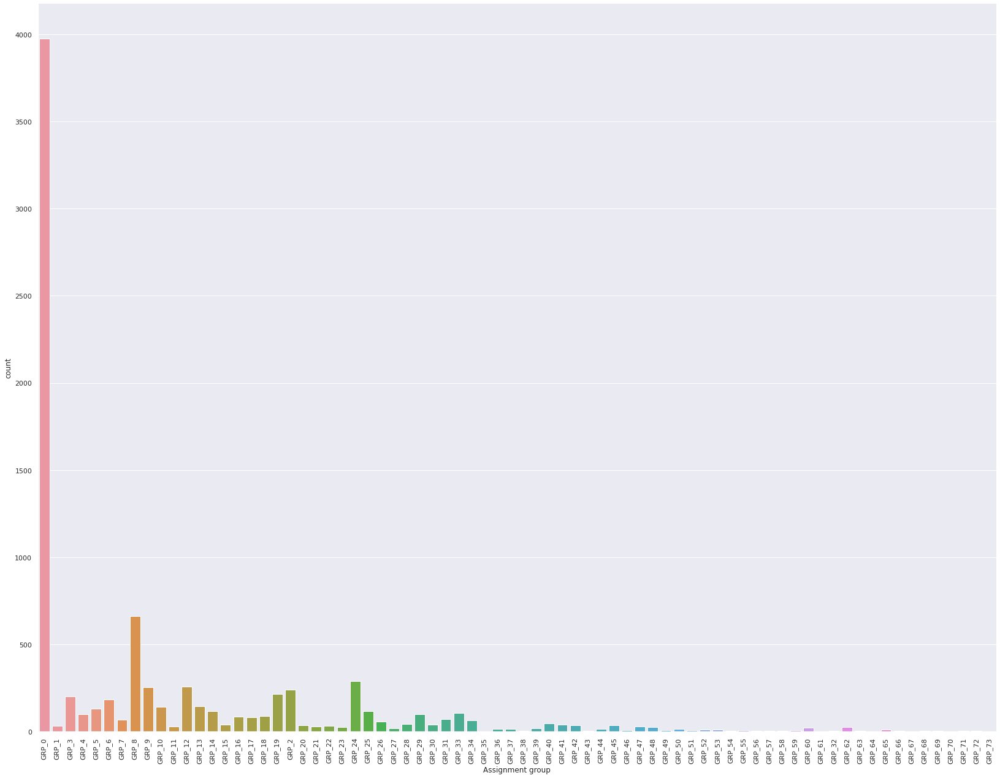

In [ ]:
import seaborn as sns
sns.set(rc={'figure.figsize':(30,15)})
sns.catplot("Assignment group",data=ticketData,kind='count')
plt.xticks(rotation=90)
fig = plt.gcf()
fig.set_size_inches( 30, 20)

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


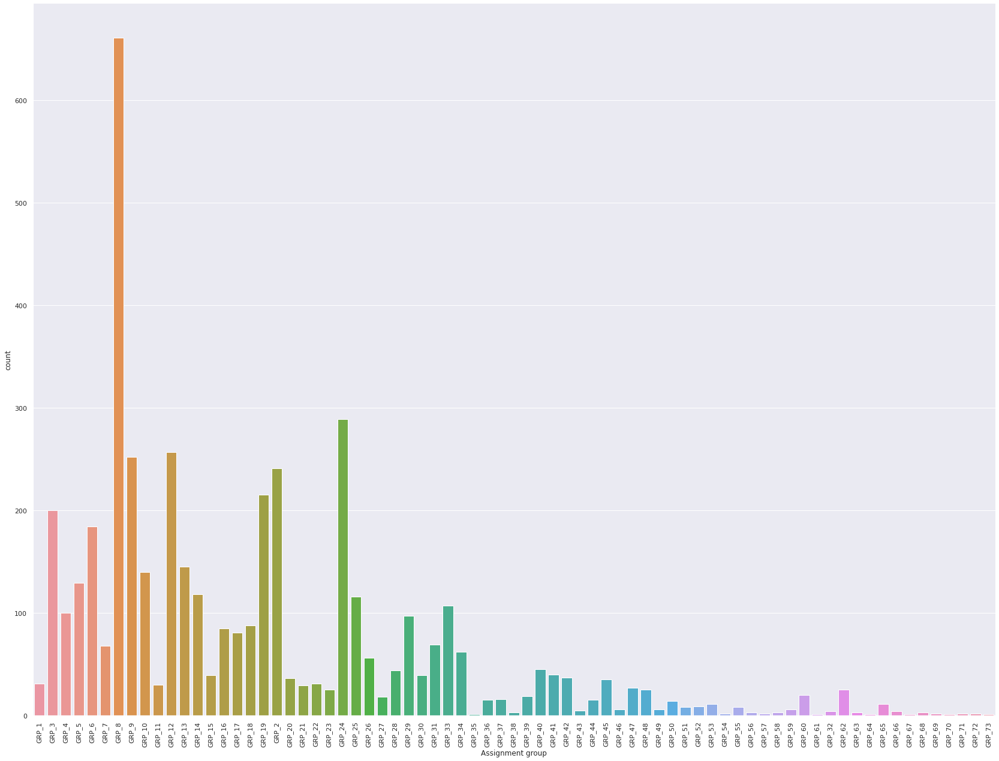

In [ ]:
ticketData_temp = ticketData[ticketData["Assignment group"] != 'GRP_0']
sns.set(rc={'figure.figsize':(30,15)})
sns.catplot("Assignment group",data=ticketData_temp,kind='count')
plt.xticks(rotation=90)
fig = plt.gcf()
fig.set_size_inches( 30, 20)

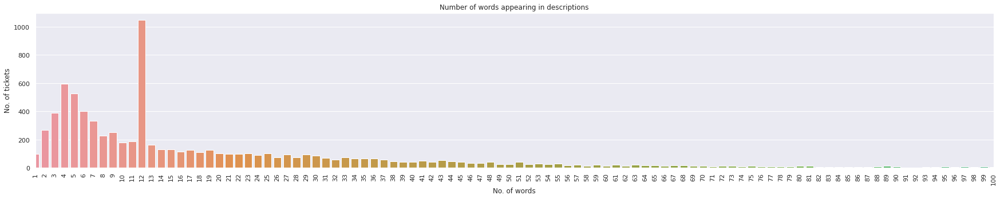

In [ ]:
plt.subplots(figsize = (30,5))

sns.countplot(x=ticketData['Description'].str.split().map(lambda x: len(x)), data=ticketData)
plt.xlabel('No. of words') 
plt.ylabel('No. of tickets') 
plt.xticks(rotation=90)
plt.title('Number of words appearing in descriptions')

plt.xlim([1, 100])
plt.show()

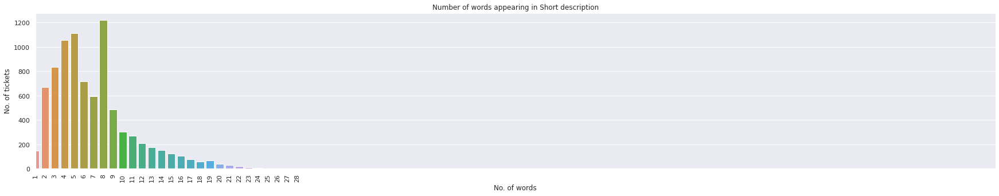

In [ ]:
plt.subplots(figsize = (30,5))

sns.countplot(x=ticketData['Short description'].str.split().map(lambda x: len(x)), data=ticketData)
plt.xlabel('No. of words') 
plt.ylabel('No. of tickets') 
plt.xticks(rotation=90)
plt.title('Number of words appearing in Short description')

plt.xlim([1, 100])
plt.show()

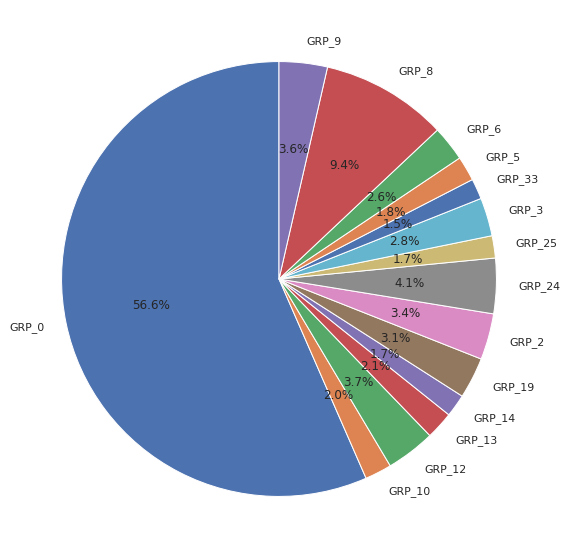

In [ ]:
ticketData_new = ticketData[ticketData['Assignment group'].map(ticketData['Assignment group'].value_counts()) > 100]

assgn_grp = pd.DataFrame(ticketData_new.groupby('Assignment group').size(),columns = ['Count']).reset_index()

plt.pie(assgn_grp["Count"], labels = assgn_grp["Assignment group"], autopct='%1.1f%%', shadow=False, startangle=90)
fig = plt.gcf()
fig.set_size_inches( 10, 10)
plt.show()

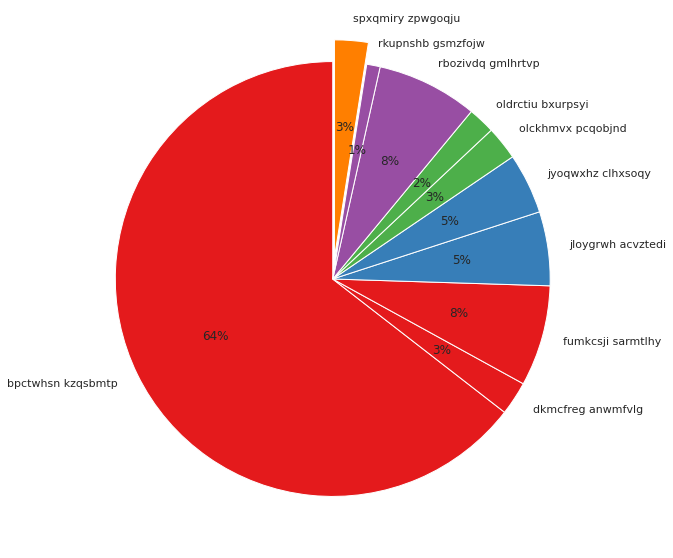

In [ ]:
ticketData_new = ticketData[ticketData['Caller'].map(ticketData['Caller'].value_counts()) > 50].head(200)

assgn_grp = pd.DataFrame(ticketData_new.groupby('Caller').size(),columns = ['Count']).reset_index()
cs=cm.Set1(np.arange(20)/20.)
explode = (0, 0, 0, 0,0,0,0,0,0,0.1)
fig1, ax1 = plt.subplots()
plt.pie(assgn_grp["Count"], labels = assgn_grp["Caller"], autopct='%1.0f%%', shadow=False, startangle=90,explode=explode,colors=cs)
fig = plt.gcf()
fig.set_size_inches( 10, 10)
plt.show()

In [ ]:
top_n = 5
s = ticketData['Caller'].groupby(ticketData['Assignment group']).value_counts()
caller_grp = pd.DataFrame(s.groupby(level=0).nlargest(top_n).reset_index(level=0, drop=True))
caller_grp.head(15)

Caller
Assignment group Caller                   
GRP_0            fumkcsji sarmtlhy     132
                 rbozivdq gmlhrtvp      86
                 olckhmvx pcqobjnd      54
                 efbwiadp dicafxhv      45
                 mfeyouli ndobtzpw      13
GRP_1            bpctwhsn kzqsbmtp       6
                 jloygrwh acvztedi       4
                 jyoqwxhz clhxsoqy       3
                 spxqmiry zpwgoqju       3
                 kbnfxpsy gehxzayq       2
GRP_10           bpctwhsn kzqsbmtp      60
                 ihfkwzjd erbxoyqk       6
                 dizquolf hlykecxa       5
                 gnasmtvx cwxtsvkm       3
                 hlrmufzx qcdzierm       3

# **Visualizing different text features**

In [ ]:
convert_dict = {
    'Short description':str,
    'Description':str,
    'Caller':str,
    'Assignment group':str,
}
tickets_df = ticketData.astype(convert_dict)

In [ ]:
tickets_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8500 entries, 0 to 8499
Data columns (total 4 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   Short description  8500 non-null   object
 1   Description        8500 non-null   object
 2   Caller             8500 non-null   object
 3   Assignment group   8500 non-null   object
dtypes: object(4)
memory usage: 265.8+ KB


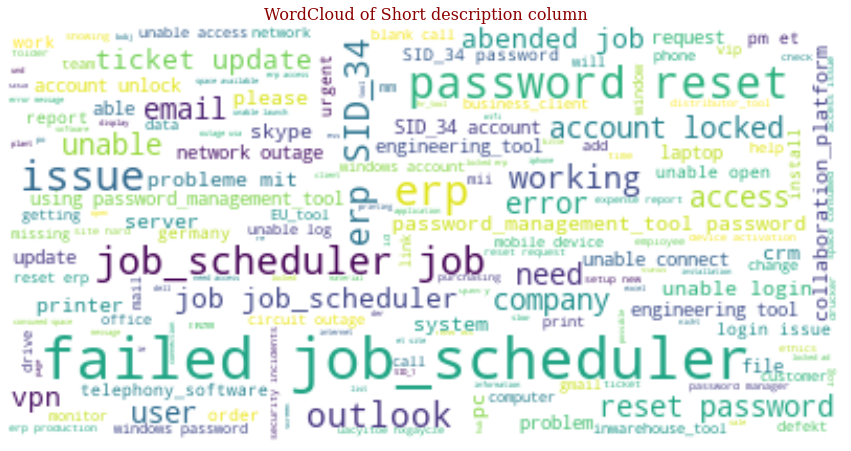

In [ ]:
font = {'family': 'serif',
        'color':  'darkred',
        'weight': 'normal',
        'size': 16,
        }

All_words = ""
All_words += " ".join(tickets_df['Short description'])
wordcloud = WordCloud(background_color='white').generate(All_words) # width and height in the wordcloud attribute does not work
plt.figure(figsize=(15,15))
plt.title("WordCloud of Short description column", fontdict=font)
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

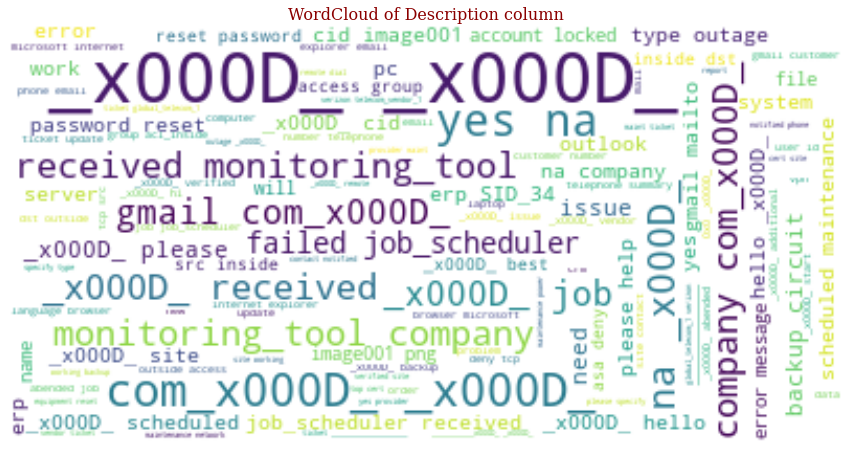

In [ ]:
font = {'family': 'serif',
        'color':  'darkred',
        'weight': 'normal',
        'size': 16,
        }

All_words = ""
All_words += " ".join(tickets_df['Description'])
wordcloud = WordCloud(background_color='white').generate(All_words) # width and height in the wordcloud attribute does not work
plt.figure(figsize=(15,15))
plt.title("WordCloud of Description column", fontdict=font)
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

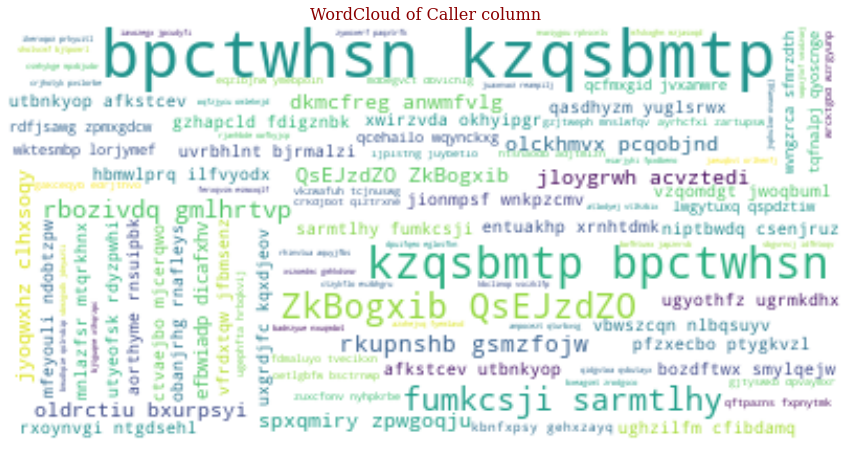

In [ ]:
font = {'family': 'serif',
        'color':  'darkred',
        'weight': 'normal',
        'size': 16,
        }

All_words = ""
All_words += " ".join(tickets_df['Caller'])
wordcloud = WordCloud(background_color='white').generate(All_words) # width and height in the wordcloud attribute does not work
plt.figure(figsize=(15,15))
plt.title("WordCloud of Caller column", fontdict=font)
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

In [ ]:
!pip install langdetect

     |████████████████████████████████| 981 kB 5.5 MB/s 
  Created wheel for langdetect: filename=langdetect-1.0.9-py3-none-any.whl size=993242 sha256=cbb567460da41fb66443aef19dfea315fd2eee65ee5a260b8c58e6dcf162b0da
  Stored in directory: /root/.cache/pip/wheels/c5/96/8a/f90c59ed25d75e50a8c10a1b1c2d4c402e4dacfa87f3aff36a
Successfully built langdetect


In [ ]:
from langdetect import detect
    
def fn_lan_detect(df):                                        
   try:                                                          
      return detect(df)                                      
   except:                                                       
      return 'no'                                                  
df_incidents=ticketData.copy()
df_incidents['Short description Language'] = df_incidents['Short description'].apply(fn_lan_detect)
df_incidents['Description Language'] = df_incidents['Description'].apply(fn_lan_detect)

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


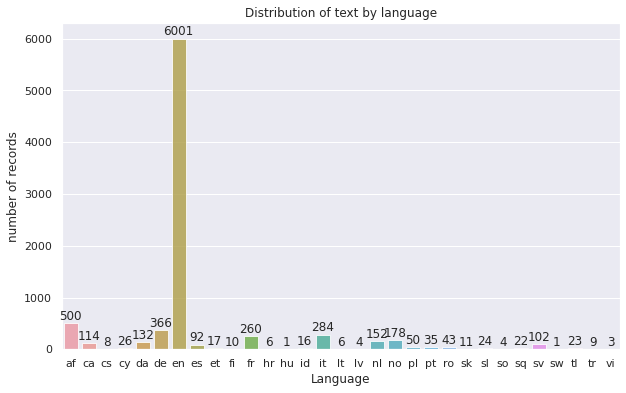

In [ ]:
x = df_incidents["Short description Language"].value_counts()
x=x.sort_index()
plt.figure(figsize=(10,6))
ax= sns.barplot(x.index, x.values, alpha=0.8)
plt.title("Distribution of text by language")
plt.ylabel('number of records')
plt.xlabel('Language')
rects = ax.patches
labels = x.values
for rect, label in zip(rects, labels):
    height = rect.get_height()
    ax.text(rect.get_x() + rect.get_width()/2, height + 5, label, ha='center', va='bottom')
plt.show();

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


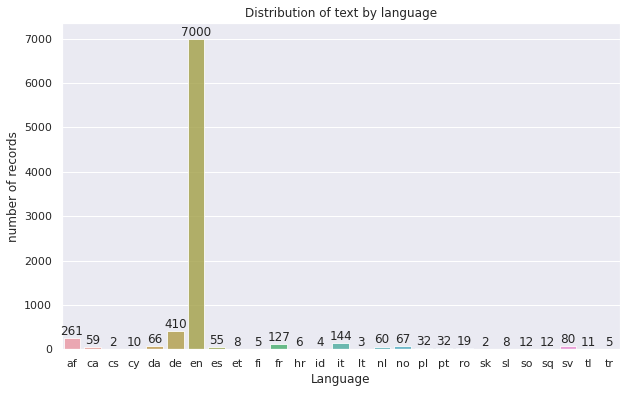

In [ ]:
x = df_incidents["Description Language"].value_counts()
x=x.sort_index()
plt.figure(figsize=(10,6))
ax= sns.barplot(x.index, x.values, alpha=0.8)
plt.title("Distribution of text by language")
plt.ylabel('number of records')
plt.xlabel('Language')
rects = ax.patches
labels = x.values
for rect, label in zip(rects, labels):
    height = rect.get_height()
    ax.text(rect.get_x() + rect.get_width()/2, height + 5, label, ha='center', va='bottom')
plt.show();

# **Text preprocessing**

In [ ]:
ticketData['Description'] = ticketData['Description'].str.replace('x000D', '')
ticketData['Short description'] = ticketData['Short description'].str.replace('x000D', '')

In [ ]:
ticketData.iloc[8471,:]

Short description                      ç”µè„‘å¼€æœºå¼€ä¸å‡ºæ¥
Description          to å°è´ºï¼Œæ—©ä¸Šç”µè„‘å¼€æœºå¼€ä¸å‡ºæ¥
Caller                                        xqyjztnm onfusvlz
Assignment group                                         GRP_30
Name: 8471, dtype: object

In [ ]:
def is_mojibake_impacted(text):
    if not badness.sequence_weirdness(text):
        # nothing weird, should be okay
        return True
    try:
        text.encode('sloppy-windows-1252')
    except UnicodeEncodeError:
        # Not CP-1252 encodable, probably fine
        return True
    else:
        # Encodable as CP-1252, Mojibake alert level high
        return False
    
# Check the dataset for mojibake impact
ticketData[~ticketData.iloc[:,:-1].applymap(is_mojibake_impacted).all(1)]

/usr/local/lib/python3.7/dist-packages/ftfy/badness.py:369: UserWarning: `sequence_weirdness()` is an old heuristic, and the current closest equivalent is `ftfy.badness.badness()`
  "`sequence_weirdness()` is an old heuristic, and the current "


,Short description,Description,Caller,Assignment group
99,password expiry tomorrow,\n\nreceived from: ecprjbod.litmjwsy@gmail.com...,ecprjbod litmjwsy,GRP_0
116,server issues,__\n__\nreceived from: bgqpotek.cuxakvml@gmail...,bgqpotek cuxakvml,GRP_0
124,mobile device activation,"from: tvcdfqgp nrbcqwgj \nsent: friday, octobe...",tvcdfqgp nrbcqwgj,GRP_0
162,access to bex,__\n__\nreceived from: yfqoaepn.xnezhsit@gmail...,yfqoaepn xnezhsit,GRP_0
164,æ’¤å›ž: ticket_no1564867 -- comments added,\n\nreceived from: abcdri@company.com\n\nwindy...,tycludks cjofwigv,GRP_0
...,...,...,...,...
8470,please review your recent ticketing_tool ticke...,"from: mikhghytr wafglhdrhjop \nsent: thursday,...",azxhejvq fyemlavd,GRP_16
8471,ç”µè„‘å¼€æœºå¼€ä¸å‡ºæ¥,to å°è´ºï¼Œæ—©ä¸Šç”µè„‘å¼€æœºå¼€ä¸å‡ºæ¥,xqyjztnm onfusvlz,GRP_30
8480,customer group enhanced field,__\n__\nreceived from: nlearzwi.ukdzstwi@gmail...,nlearzwi ukdzstwi,GRP_9
8498,machine nÃ£o estÃ¡ funcionando,i am unable to access the machine utilities to...,ufawcgob aowhxjky,GRP_62


In [ ]:
print('Grabled text: \033[1m%s\033[0m\nFixed text: \033[1m%s\033[0m' % (ticketData['Short description'][8471], 
                                                                        fix_text(ticketData['Short description'][8471])))

Grabled text: ç”µè„‘å¼€æœºå¼€ä¸å‡ºæ¥
Fixed text: 电脑开机开不出来


In [ ]:
ticketData['Short description'] = ticketData['Short description'].apply(fix_text)
ticketData['Description'] = ticketData['Description'].apply(fix_text)

# Visualize that row# 8471
ticketData.iloc[8471,:]

Short description             电脑开机开不出来
Description           to 小贺,早上电脑开机开不出来
Caller               xqyjztnm onfusvlz
Assignment group                GRP_30
Name: 8471, dtype: object

In [ ]:
print(googletrans.LANGUAGES)
translator=Translator()

{'af': 'afrikaans', 'sq': 'albanian', 'am': 'amharic', 'ar': 'arabic', 'hy': 'armenian', 'az': 'azerbaijani', 'eu': 'basque', 'be': 'belarusian', 'bn': 'bengali', 'bs': 'bosnian', 'bg': 'bulgarian', 'ca': 'catalan', 'ceb': 'cebuano', 'ny': 'chichewa', 'zh-cn': 'chinese (simplified)', 'zh-tw': 'chinese (traditional)', 'co': 'corsican', 'hr': 'croatian', 'cs': 'czech', 'da': 'danish', 'nl': 'dutch', 'en': 'english', 'eo': 'esperanto', 'et': 'estonian', 'tl': 'filipino', 'fi': 'finnish', 'fr': 'french', 'fy': 'frisian', 'gl': 'galician', 'ka': 'georgian', 'de': 'german', 'el': 'greek', 'gu': 'gujarati', 'ht': 'haitian creole', 'ha': 'hausa', 'haw': 'hawaiian', 'iw': 'hebrew', 'he': 'hebrew', 'hi': 'hindi', 'hmn': 'hmong', 'hu': 'hungarian', 'is': 'icelandic', 'ig': 'igbo', 'id': 'indonesian', 'ga': 'irish', 'it': 'italian', 'ja': 'japanese', 'jw': 'javanese', 'kn': 'kannada', 'kk': 'kazakh', 'km': 'khmer', 'ko': 'korean', 'ku': 'kurdish (kurmanji)', 'ky': 'kyrgyz', 'lo': 'lao', 'la': 'lat

In [ ]:
ticketData['Short description'] = ticketData['Short description'].apply(lambda x: translator.translate(x, dest='en').text)
ticketData['Description'] = ticketData['Description'].apply(lambda x: translator.translate(x, dest='en').text)

In [ ]:
ticketData.iloc[8471,:]

Short description                               Computer won't turn on
Description          to Xiaohe, the computer can't be turned on in ...
Caller                                               xqyjztnm onfusvlz
Assignment group                                                GRP_30
Name: 8471, dtype: object

In [ ]:
from dateutil import parser
def is_valid_date(date_str):
    try:
        parser.parse(date_str)
        return True
    except:
        return False
callers = ticketData['Caller'].unique() 
callers.shape
def clean_data(text):
    text=text.lower()
    text = ' '.join([w for w in text.split() if not is_valid_date(w)])
    text = re.sub(r"received from:",' ',text)
    text = re.sub(r"from:",' ',text)
    text = re.sub(r"to:",' ',text)
    text = re.sub(r"subject:",' ',text)
    text = re.sub(r"sent:",' ',text)
    text = re.sub(r"ic:",' ',text)
    text = re.sub(r"cc:",' ',text)
    text = re.sub(r"bcc:",' ',text)
    #Remove email 
    text = re.sub(r'\S*@\S*\s?', '', text)
    # Remove numbers 
    text = re.sub(r'\d+','' ,text)
    # Remove Non Dictionary character-TODO
    # Remove new line characters 
    text = re.sub(r'\n',' ',text)
    # Remove hashtag while keeping hashtag text
    text = re.sub(r'#','', text)
    #& 
    text = re.sub(r'&;?', 'and',text)
    # Remove HTML special entities (e.g. &amp;)
    text = re.sub(r'\&\w*;', '', text)
    # Remove hyperlinks
    text = re.sub(r'https?:\/\/.*\/\w*', '', text)  
    # Remove characters beyond Readable formart by Unicode:
    text= ''.join(c for c in text if c <= '\uFFFF') 
    text = text.strip()
    # Remove unreadable characters  (also extra spaces)
    text = ' '.join(re.sub("[^\u0030-\u0039\u0041-\u005a\u0061-\u007a]", " ", text).split())
    for name in callers:
      namelist = [part for part in name.split()]
      for namepart in namelist: 
          text = text.replace(namepart,'')
          
    text = re.sub(r"\s+[a-zA-Z]\s+", ' ', text)
    text = re.sub(' +', ' ', text)
    text = text.strip()
    return text
  
ticketData['Description'] = ticketData['Description'].apply(clean_data)
ticketData['Short description'] = ticketData['Short description'].apply(clean_data)


In [ ]:
ticketData.head()

,Short description,Description,Caller,Assignment group
0,login issue,verified user details employee and manager nam...,spxjnwir pjlcoqds,GRP_0
1,outlook,hello team my meetings skype meetings etc are ...,hmjdrvpb komuaywn,GRP_0
2,cant log in to vpn,hi cannot log on to vpn best,eylqgodm ybqkwiam,GRP_0
3,unable to access hr tool page,unable to access hr tool page,xbkucsvz gcpydteq,GRP_0
4,skype error,skype error,owlgqjme qhcozdfx,GRP_0


In [ ]:
ticketData['Combined Description'] = ticketData['Short description'].str.cat(ticketData['Description'], sep=' ', na_rep=' ')
ticketData.head()

,Short description,Description,Caller,Assignment group,Combined Description
0,login issue,verified user details employee and manager nam...,spxjnwir pjlcoqds,GRP_0,login issue verified user details employee and...
1,outlook,hello team my meetings skype meetings etc are ...,hmjdrvpb komuaywn,GRP_0,outlook hello team my meetings skype meetings ...
2,cant log in to vpn,hi cannot log on to vpn best,eylqgodm ybqkwiam,GRP_0,cant log in to vpn hi cannot log on to vpn best
3,unable to access hr tool page,unable to access hr tool page,xbkucsvz gcpydteq,GRP_0,unable to access hr tool page unable to access...
4,skype error,skype error,owlgqjme qhcozdfx,GRP_0,skype error skype error


In [ ]:
ticketData["Combined Description"] = ticketData["Combined Description"].apply(lambda x: ' '.join(pd.unique(x.split())))
ticketData.head()

,Short description,Description,Caller,Assignment group,Combined Description
0,login issue,verified user details employee and manager nam...,spxjnwir pjlcoqds,GRP_0,login issue verified user details employee and...
1,outlook,hello team my meetings skype meetings etc are ...,hmjdrvpb komuaywn,GRP_0,outlook hello team my meetings skype etc are n...
2,cant log in to vpn,hi cannot log on to vpn best,eylqgodm ybqkwiam,GRP_0,cant log in to vpn hi cannot on best
3,unable to access hr tool page,unable to access hr tool page,xbkucsvz gcpydteq,GRP_0,unable to access hr tool page
4,skype error,skype error,owlgqjme qhcozdfx,GRP_0,skype error


In [ ]:
ticketData['Description WordCount'] = [len(desc.split(' ')) for desc in ticketData['Combined Description']]
ticketData.head()
wordCount_before = ticketData['Description WordCount'].sum()

In [ ]:
print("Total Corpus Word Count: ", wordCount_before)

Total Corpus Word Count:  162353


In [ ]:
ticketData.head()

,Short description,Description,Caller,Assignment group,Combined Description,Description WordCount
0,login issue,verified user details employee and manager nam...,spxjnwir pjlcoqds,GRP_0,login issue verified user details employee and...,25
1,outlook,hello team my meetings skype meetings etc are ...,hmjdrvpb komuaywn,GRP_0,outlook hello team my meetings skype etc are n...,21
2,cant log in to vpn,hi cannot log on to vpn best,eylqgodm ybqkwiam,GRP_0,cant log in to vpn hi cannot on best,9
3,unable to access hr tool page,unable to access hr tool page,xbkucsvz gcpydteq,GRP_0,unable to access hr tool page,6
4,skype error,skype error,owlgqjme qhcozdfx,GRP_0,skype error,2


In [ ]:
from nltk.corpus import stopwords
import nltk
nltk.download('wordnet')
nltk.download('punkt')
nltk.download('stopwords')
nltk.download('averaged_perceptron_tagger') 

sr = stopwords.words('english')
for i,text in enumerate(ticketData['Combined Description']):
  ticketData['Combined Description'][i]=" ".join(word for word in text.split(' ') if word not in sr)

# install spacy and plt for gensim  
!pip install -q spacy
import spacy
nlp = spacy.load('en_core_web_sm', disable=['parser', 'ner'])
allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV']
def lemmatize_text(text):
    doc = nlp(text)
    return ' '.join([token.lemma_ for token in doc])

ticketData['Clean Description'] = ticketData['Combined Description'].apply(lemmatize_text)

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Unzipping corpora/wordnet.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger.zip.


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # Remove the CWD from sys.path while we load stuff.


In [ ]:
ticketData['Clean WordCount'] = [len(desc.split(' ')) for desc in ticketData['Clean Description']]
ticketData.head()

,Short description,Description,Caller,Assignment group,Combined Description,Description WordCount,Clean Description,Clean WordCount
0,login issue,verified user details employee and manager nam...,spxjnwir pjlcoqds,GRP_0,login issue verified user details employee man...,25,login issue verify user detail employee manage...,18
1,outlook,hello team my meetings skype meetings etc are ...,hmjdrvpb komuaywn,GRP_0,outlook hello team meetings skype etc appearin...,21,outlook hello team meeting skype etc appear ca...,13
2,cant log in to vpn,hi cannot log on to vpn best,eylqgodm ybqkwiam,GRP_0,cant log vpn hi cannot best,9,can not log vpn hi can not good,8
3,unable to access hr tool page,unable to access hr tool page,xbkucsvz gcpydteq,GRP_0,unable access hr tool page,6,unable access hr tool page,5
4,skype error,skype error,owlgqjme qhcozdfx,GRP_0,skype error,2,skype error,2


In [ ]:
wordCount_after = ticketData['Clean WordCount'].sum()

In [ ]:
print("Total Corpus after Word Count: ", wordCount_after)

Total Corpus after Word Count:  114903


In [ ]:
ticketData.to_csv('preprocessed_ticket.csv', index=False, encoding='utf_8_sig')
with open('preprocessed_ticket.pkl','wb') as f:
    pickle.dump(ticketData, f, pickle.HIGHEST_PROTOCOL)
with open('preprocessed_ticket.pkl','rb') as f:
    ticketData = pickle.load(f)

In [ ]:
ticketData.drop(['Short description','Description','Caller','Combined Description','Description WordCount','Clean WordCount'],axis=1,inplace=True)

In [ ]:
ticketData.head()

,Assignment group,Clean Description
0,GRP_0,login issue verify user detail employee manage...
1,GRP_0,outlook hello team meeting skype etc appear ca...
2,GRP_0,can not log vpn hi can not good
3,GRP_0,unable access hr tool page
4,GRP_0,skype error


In [ ]:
ticketData.to_csv('clean_ticket.csv', index=False, encoding='utf_8_sig')
with open('clean_ticket.pkl','wb') as f:
    pickle.dump(ticketData, f, pickle.HIGHEST_PROTOCOL)

In [ ]:
import pickle
with open('clean_ticket.pkl','rb') as f:
    ticketData = pickle.load(f)

In [ ]:
ticketData.head()

,Assignment group,Clean Description
0,GRP_0,login issue verify user detail employee manage...
1,GRP_0,outlook hello team meeting skype etc appear ca...
2,GRP_0,can not log vpn hi can not good
3,GRP_0,unable access hr tool page
4,GRP_0,skype error


In [ ]:
from nltk.corpus import stopwords
import nltk
nltk.download('wordnet')
nltk.download('punkt')
nltk.download('stopwords')
nltk.download('averaged_perceptron_tagger') 

sr = stopwords.words('english')

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Unzipping corpora/wordnet.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger.zip.


In [ ]:
def generate_word_clod(corpus,grpName):
    # mask = np.array(Image.open('cloud2.png'))
    # Instantiate the wordcloud object
    wordcloud = WordCloud(width = 800, height = 800, 
                    background_color ='black', 
                    stopwords=sr,
                    # mask=mask,
                    min_font_size = 10,max_words=50).generate(corpus)

    # plot the WordCloud image                        
    plt.figure(figsize = (12, 12), facecolor = None) 
    plt.title("Most common 50 words of {}".format(grpName))
    plt.imshow(wordcloud) 
    plt.axis("off") 
    plt.tight_layout(pad = 0) 

    plt.show()

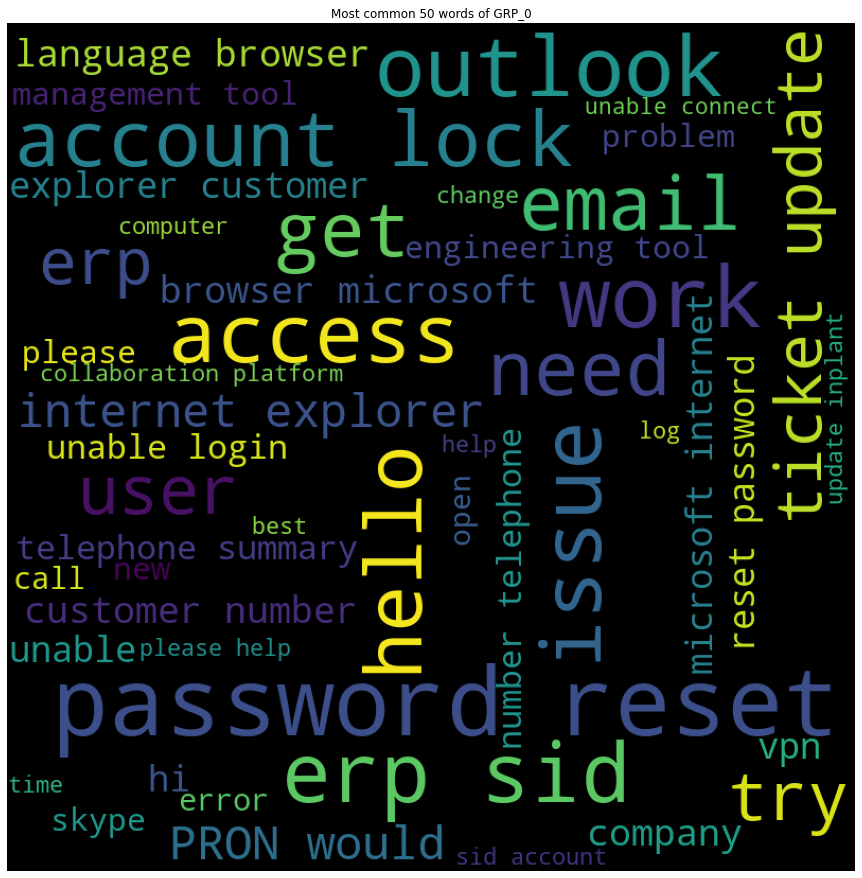

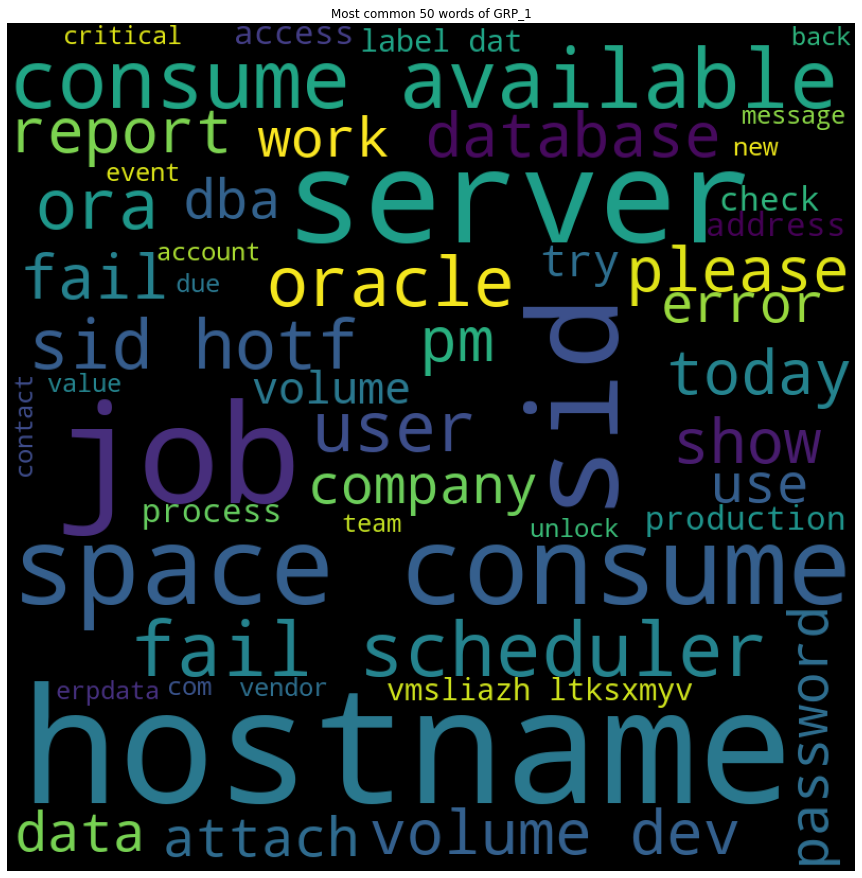

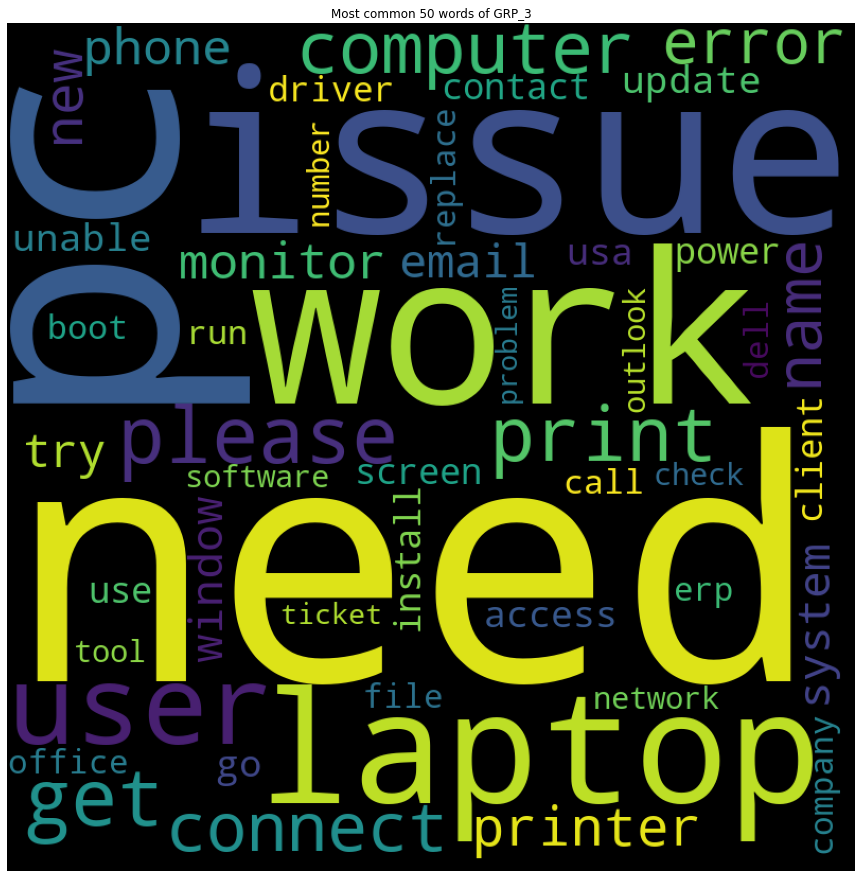

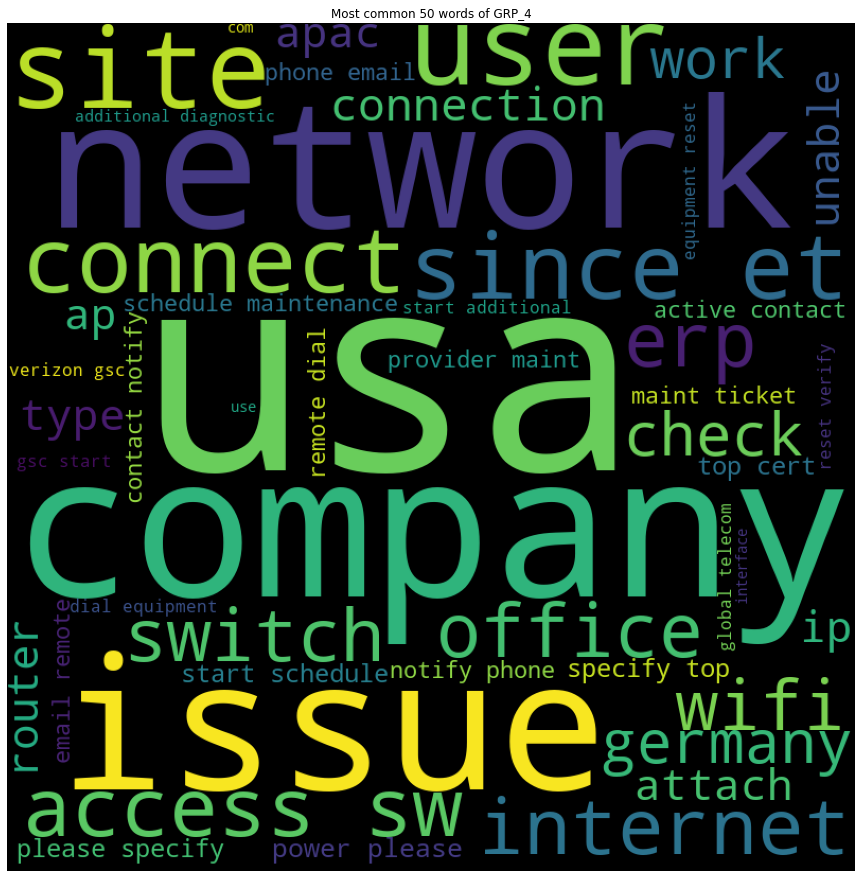

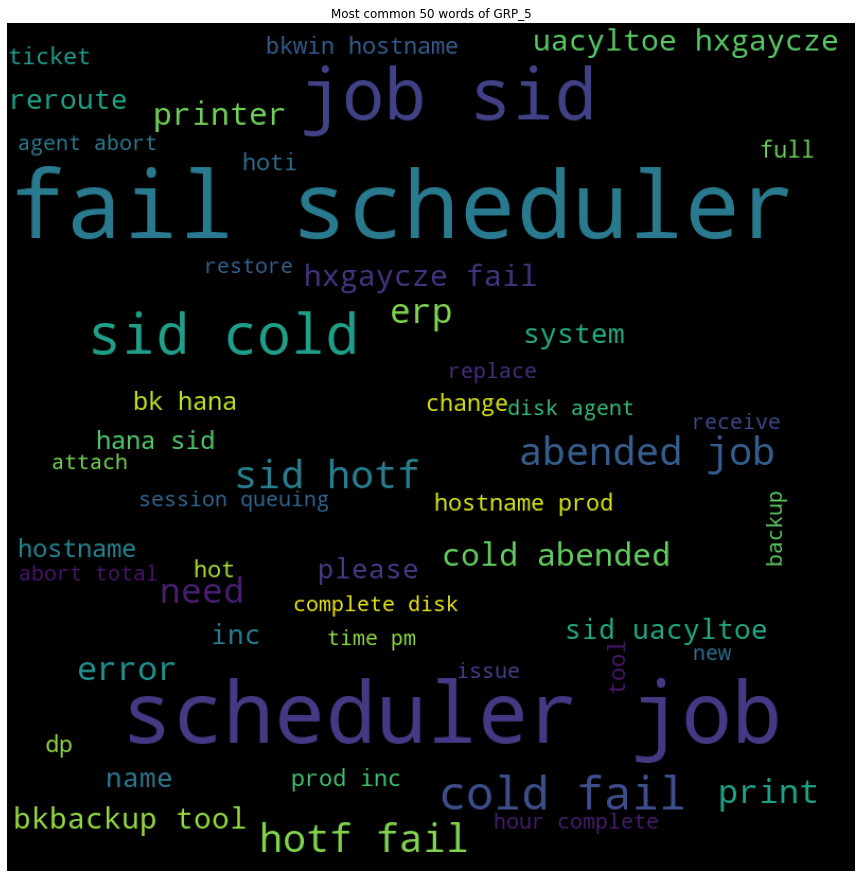

...

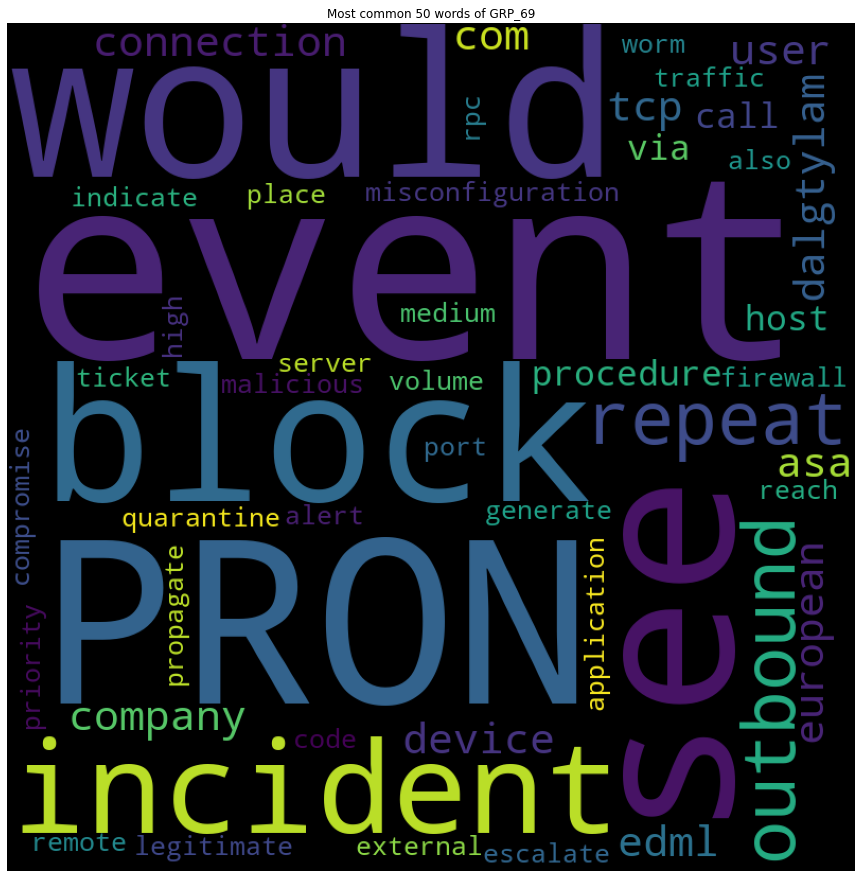

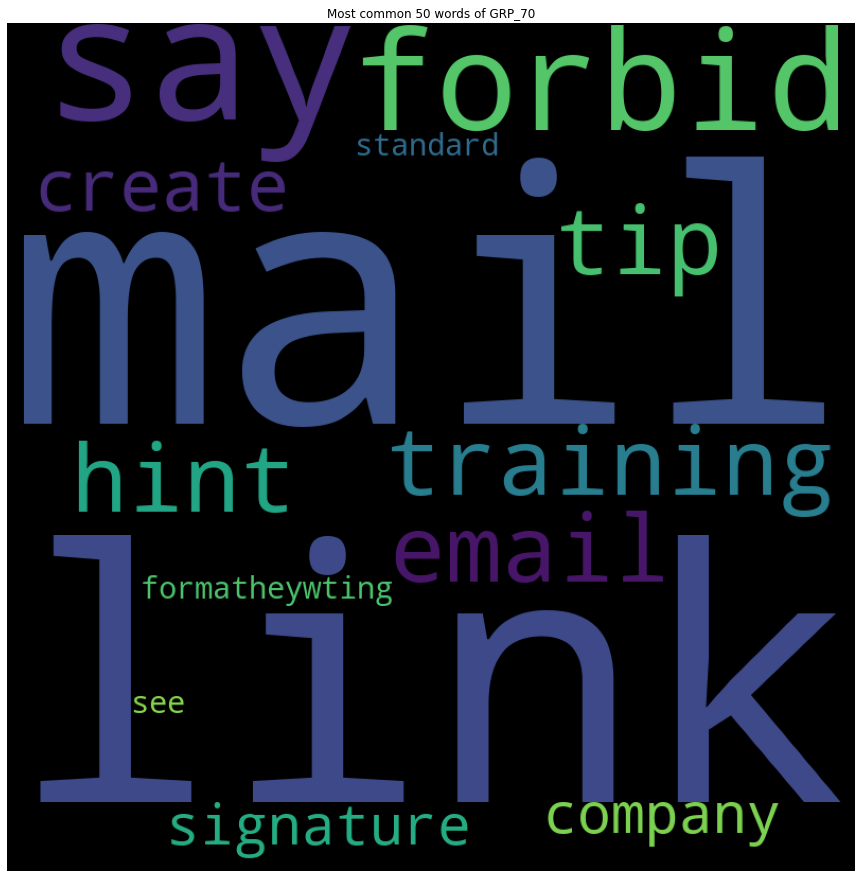

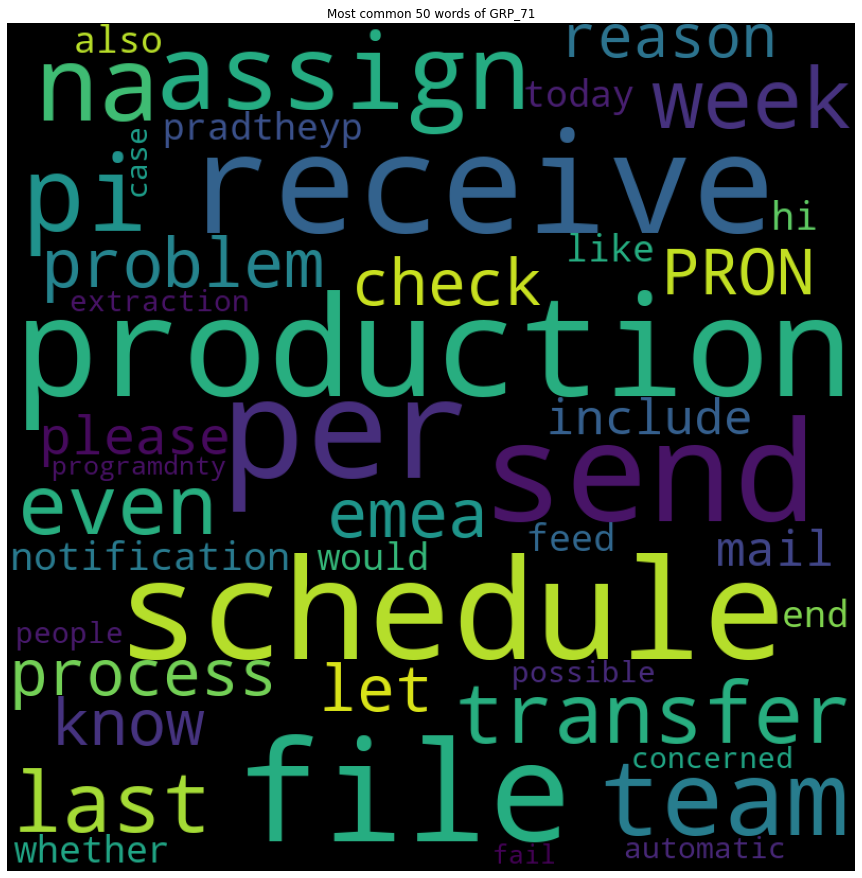

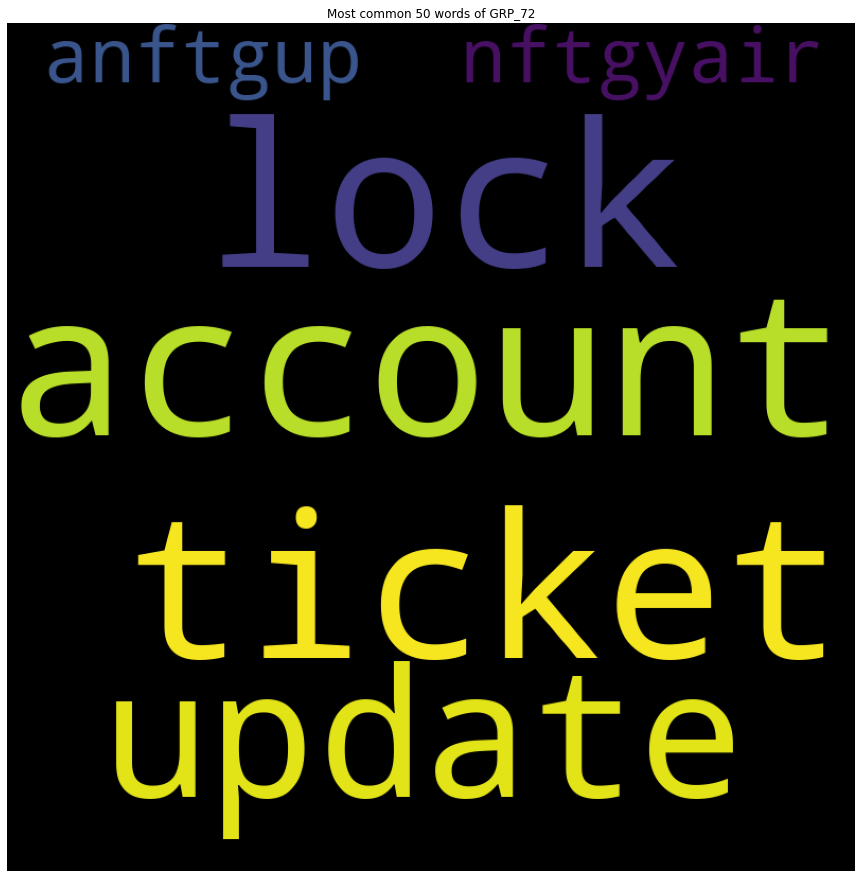

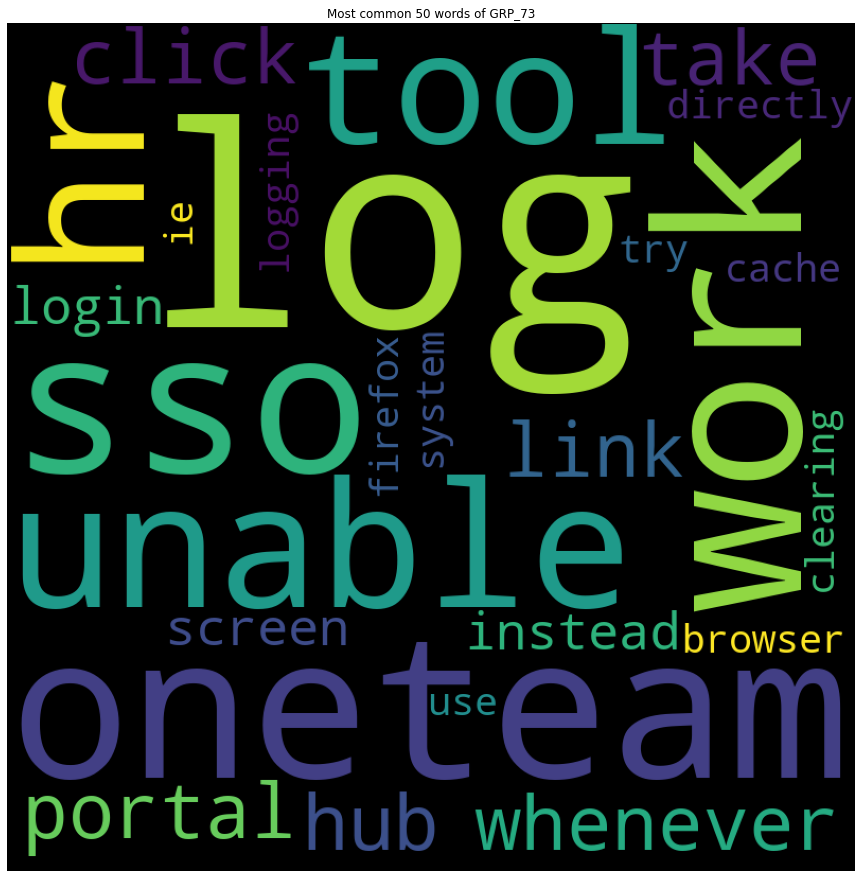

In [ ]:
for grp in ticketData['Assignment group'].unique():
  generate_word_clod(' '.join(ticketData[ticketData['Assignment group'] == grp]['Clean Description'].str.strip()),grp)

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer

cv = CountVectorizer(stop_words='english')
data_cv = cv.fit_transform(ticketData['Clean Description'])
data_dtm = pd.DataFrame(data_cv.toarray(), columns=cv.get_feature_names())
data_dtm.index = ticketData.index
data_dtm

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,aa,aaa,aacbcc,aacount,aae,aao,aaplant,ab,abandon,abap,...,zuteillisten,zvgixwksid,zw,zwip,zwkfzfqhveyrfplvnznkjsmckqwehilqgumjnxnqprprqkdhi,zwwirep,zwwzwsnkerplcb,zz,zzcmpgn,zzsdspc
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8495,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
8496,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
8497,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
8498,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
data_dtm['Assignment group']=ticketData['Assignment group']

In [ ]:
data_dtm

,aa,aaa,aacbcc,aacount,aae,aao,aaplant,ab,abandon,abap,...,zvgixwksid,zw,zwip,zwkfzfqhveyrfplvnznkjsmckqwehilqgumjnxnqprprqkdhi,zwwirep,zwwzwsnkerplcb,zz,zzcmpgn,zzsdspc,Assignment group
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,GRP_0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,GRP_0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,GRP_0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,GRP_0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,GRP_0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8495,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,GRP_29
8496,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,GRP_0
8497,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,GRP_0
8498,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,GRP_62


In [ ]:
data_dtm.to_pickle("vectorized.pkl")

In [ ]:
data = data_dtm.transpose()
data

,0,1,2,3,4,5,6,7,8,9,...,8490,8491,8492,8493,8494,8495,8496,8497,8498,8499
aa,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
aaa,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
aacbcc,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
aacount,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
aae,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
zwwzwsnkerplcb,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
zz,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,0,0
zzcmpgn,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
zzsdspc,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
while True:pass

KeyboardInterrupt: ignored